In [1]:
#################################################
# Dependencies
#################################################
from flask import Flask, jsonify, render_template
from pymongo import MongoClient
from bson.json_util import dumps
import numpy as np
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
import matplotlib.pyplot as plt
from nltk.stem import WordNetLemmatizer
import pandas as pd

In [2]:
result_df = pd.read_json("../final_data_for_machine_learning.json")
result_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 189489 entries, 0 to 189488
Data columns (total 10 columns):
 #   Column          Non-Null Count   Dtype 
---  ------          --------------   ----- 
 0   comment         189489 non-null  object
 1   category        189489 non-null  object
 2   channel         189489 non-null  object
 3   video_url       189489 non-null  object
 4   video_id        189489 non-null  object
 5   channel_size    189489 non-null  object
 6   identity        189489 non-null  object
 7   expanded_text   189489 non-null  object
 8   processed_text  189489 non-null  object
 9   score           189489 non-null  int64 
dtypes: int64(1), object(9)
memory usage: 15.9+ MB


In [3]:
categories = result_df["category"].unique()
categories

array(['Automobiles', 'Comedy', 'Entertainment', 'Film',
       'News and Politics', 'Gaming', 'Science and Technology', 'Shows',
       'Sports', 'Pets and Animals', 'Music', 'Travel', 'Problematic',
       'Education', 'Howto', 'Nonprofit', 'People'], dtype=object)

/var/folders/d4/k_1cw48975s3slrc9qk3wnwc0000gn/T/ipykernel_67969/3897122433.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp_df['text_lem'] = temp_df['processed_text'].apply(wordnet_lem.lemmatize)
/var/folders/d4/k_1cw48975s3slrc9qk3wnwc0000gn/T/ipykernel_67969/3897122433.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp_df['text_lem'] = temp_df['processed_text'].apply(wordnet_lem.lemmatize)
/var/folders/d4/k_1cw48975s3slrc9qk3wnwc0000gn/T/ipykernel_67969/3897122433.py:8: SettingWithCopyWarni

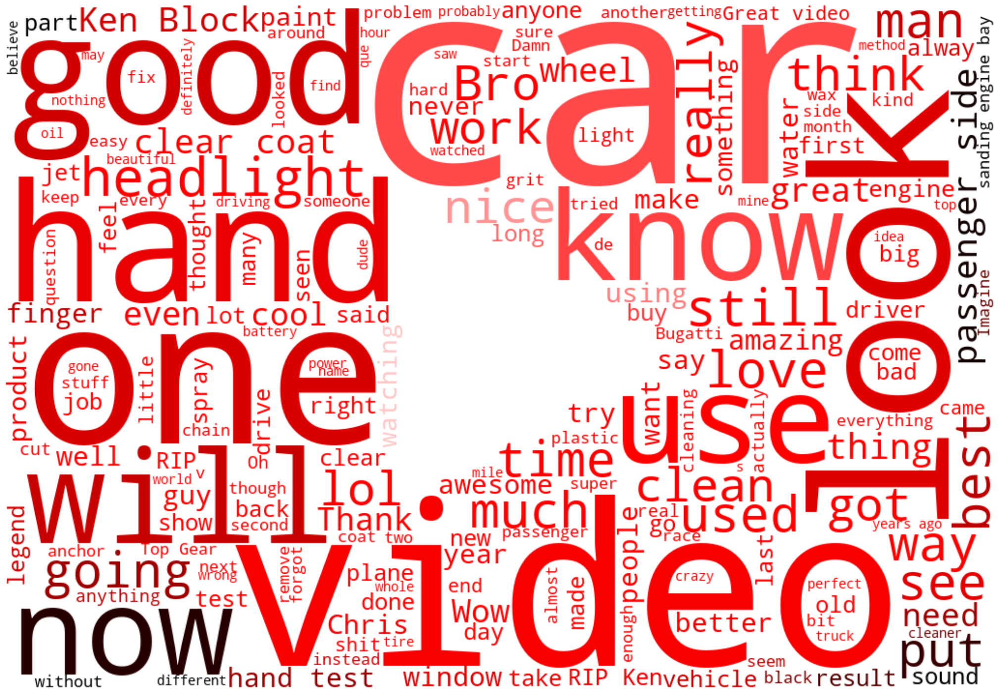

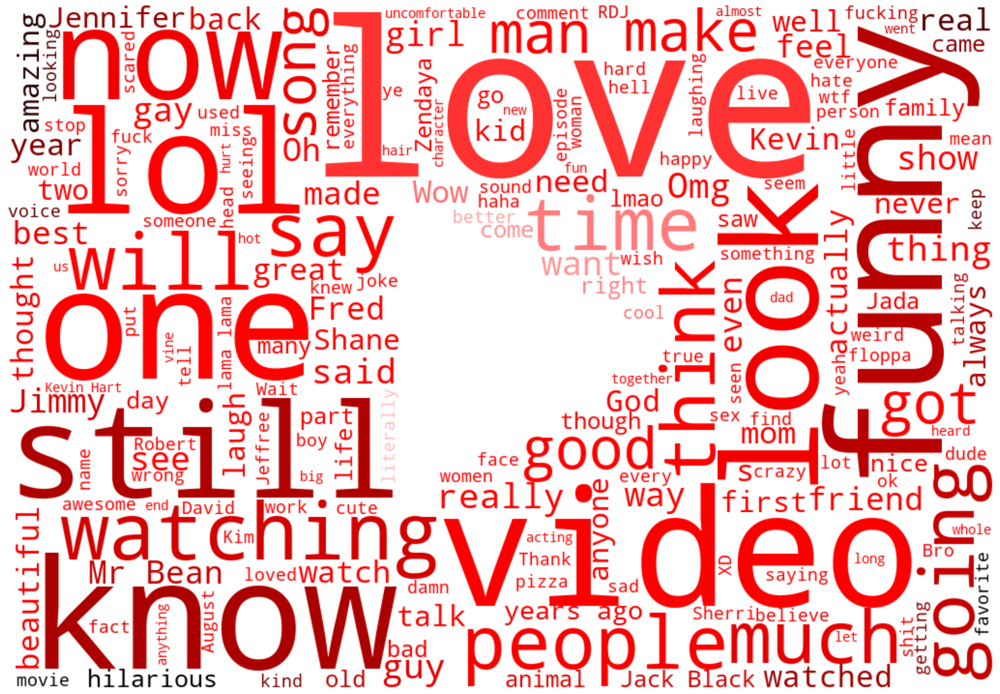

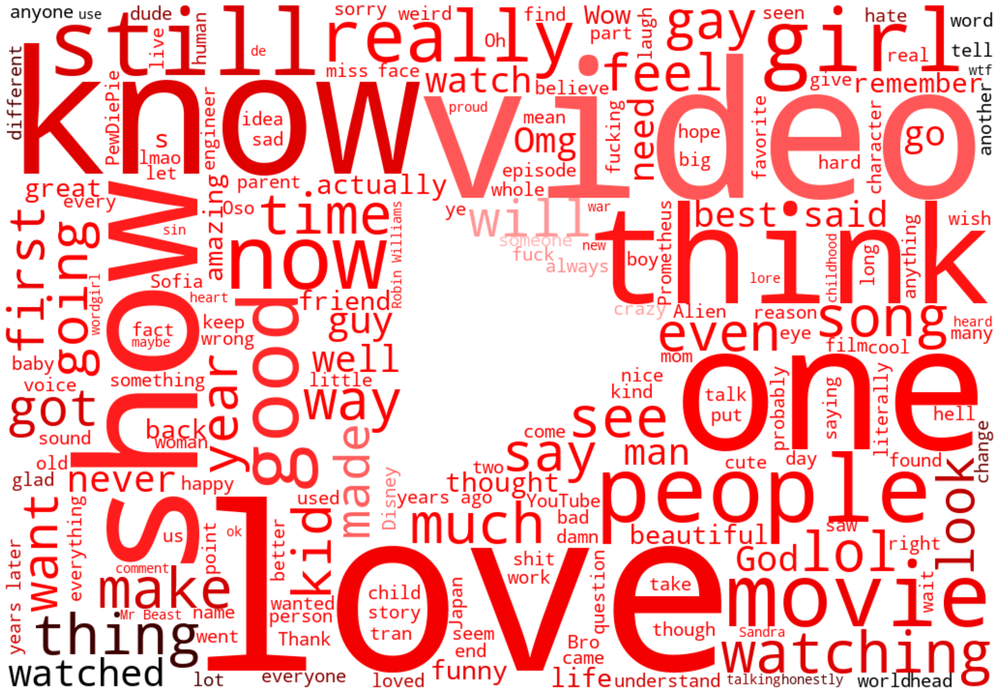

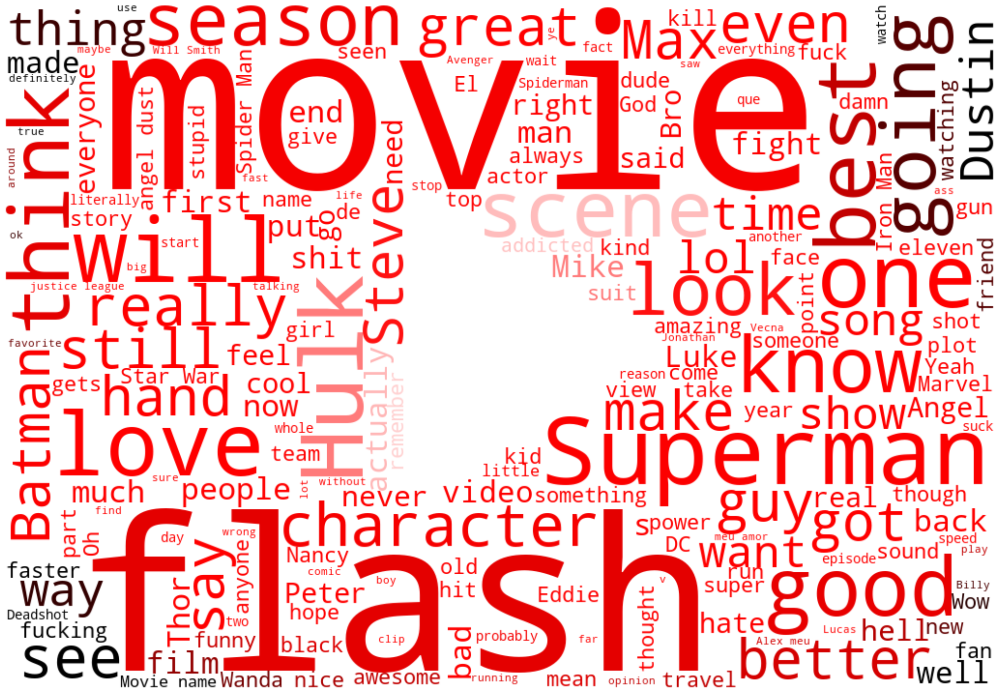

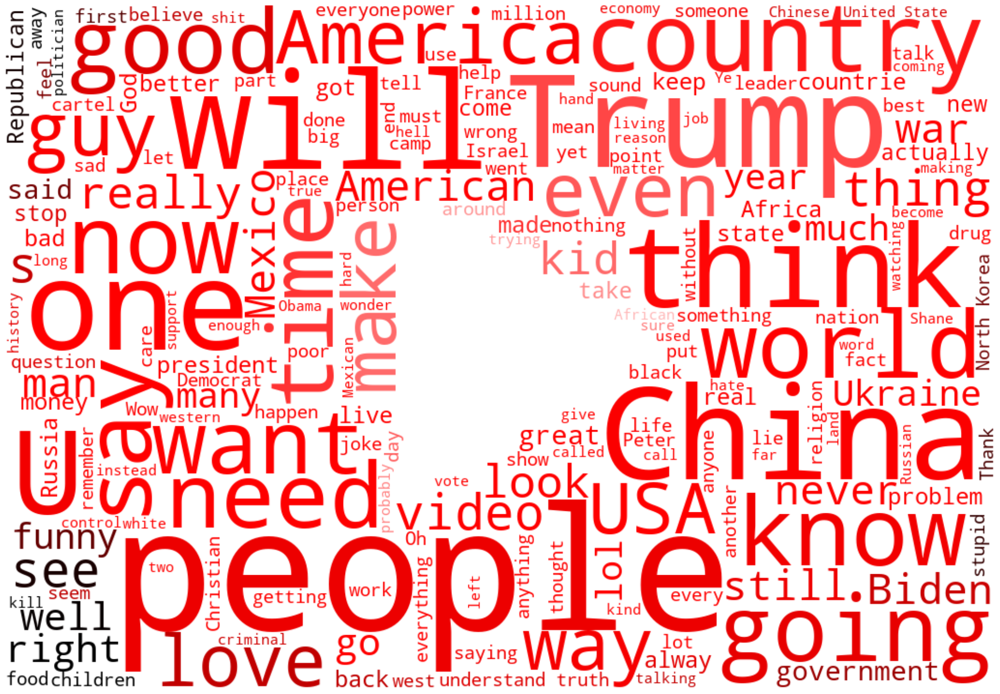

...

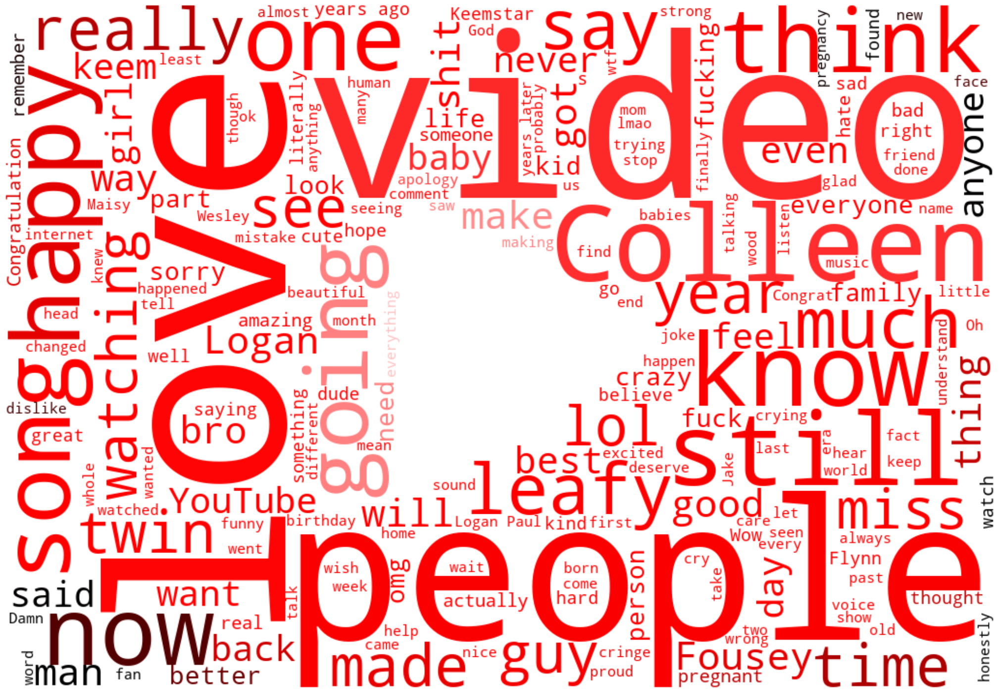

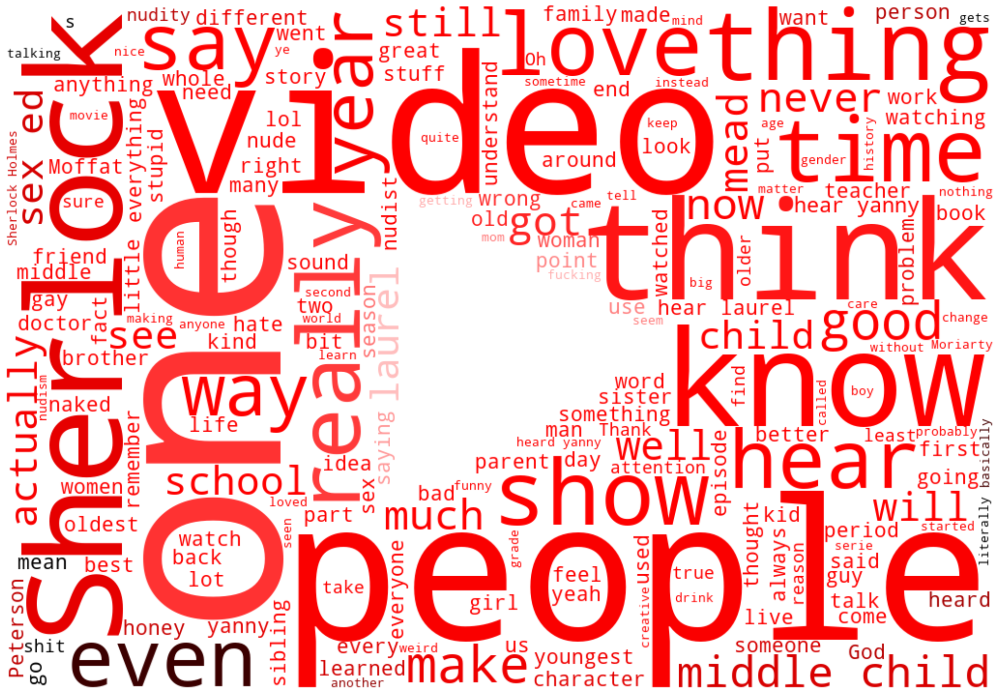

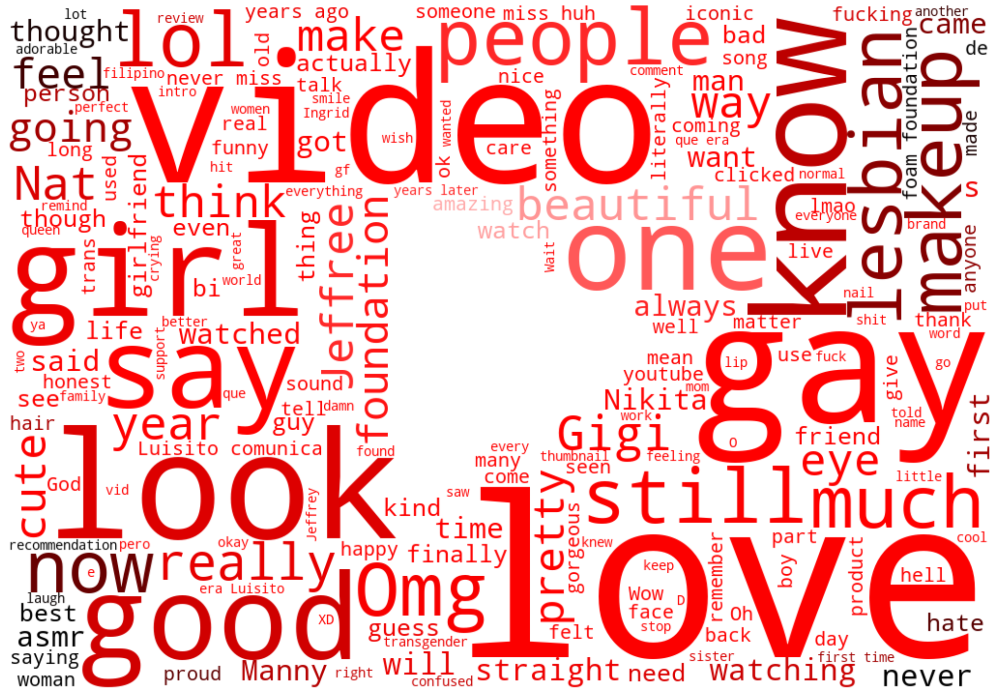

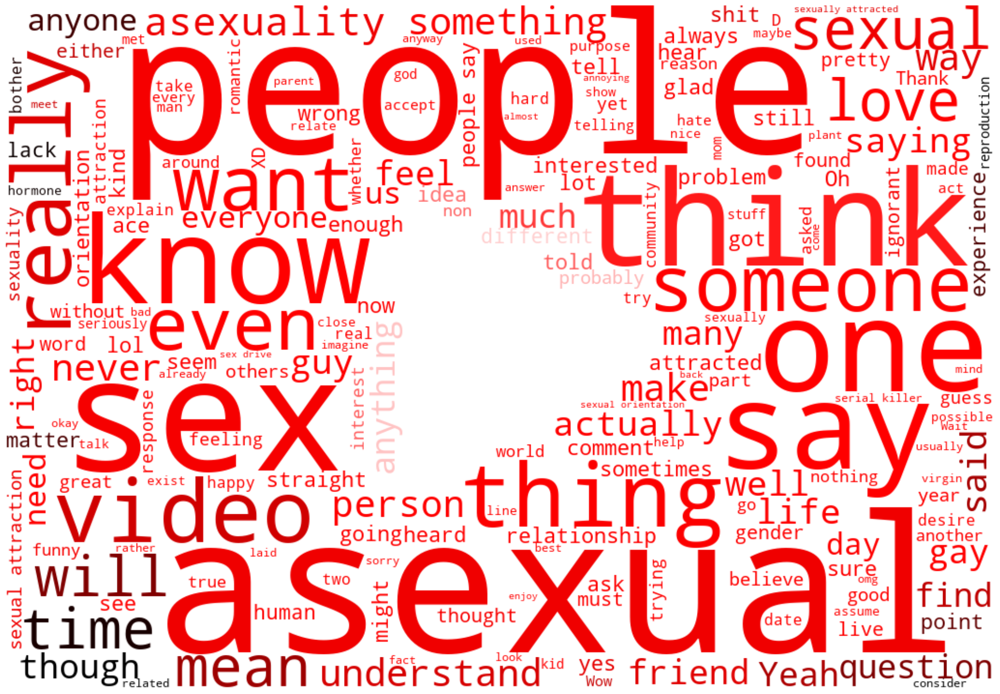

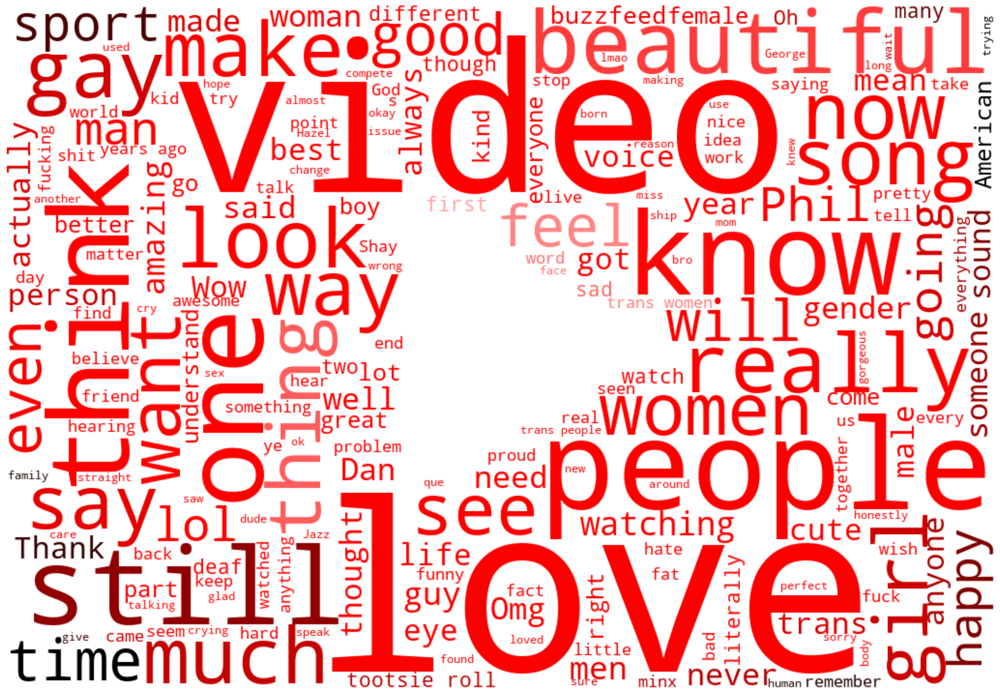

In [4]:
# Initialize Lemmatize

for x in categories:
    wordnet_lem = WordNetLemmatizer()

    temp_df = result_df[result_df["category"] == x]
    # Lemmatize processed text and join everything in a list
    temp_df['text_lem'] = temp_df['processed_text'].apply(wordnet_lem.lemmatize)
    all_words_lem = ' '.join([word for word in temp_df['text_lem']])

    # Generate a word cloud image
    mask = np.array(Image.open("youtube.png"))
    stopwords = set(STOPWORDS)

    wordcloud_yt = WordCloud(height=708,
                                width=1024,
                                background_color="white",
                                mode="RGBA",
                                stopwords=stopwords,
                                mask=mask).generate(all_words_lem)

    # Create coloring from the image
    image_colors = ImageColorGenerator(mask)
    plt.figure(figsize=[20,20])
    plt.axis('off')
    plt.tight_layout(pad=0)
    plt.imshow(wordcloud_yt.recolor(color_func=image_colors), interpolation="bilinear")
    plt.savefig(f"wordcloud_{x}.png")

In [5]:
identities = result_df["identity"].unique()
identities

array(['unknown', 'lgbt'], dtype=object)

/var/folders/d4/k_1cw48975s3slrc9qk3wnwc0000gn/T/ipykernel_67969/492175702.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp_df['text_lem'] = temp_df['processed_text'].apply(wordnet_lem.lemmatize)
/var/folders/d4/k_1cw48975s3slrc9qk3wnwc0000gn/T/ipykernel_67969/492175702.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp_df['text_lem'] = temp_df['processed_text'].apply(wordnet_lem.lemmatize)


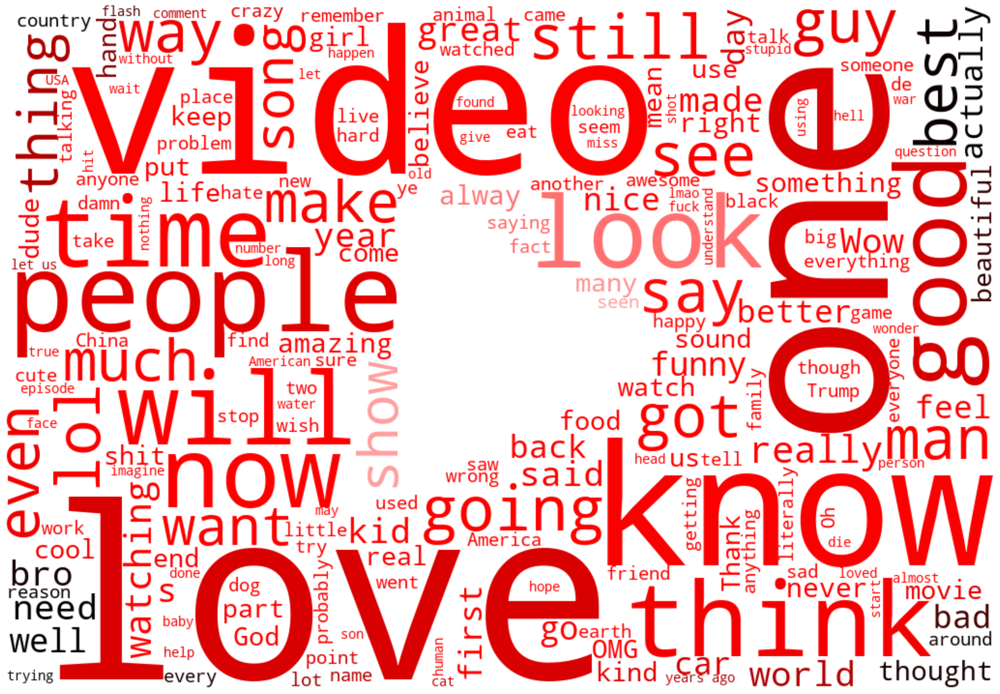

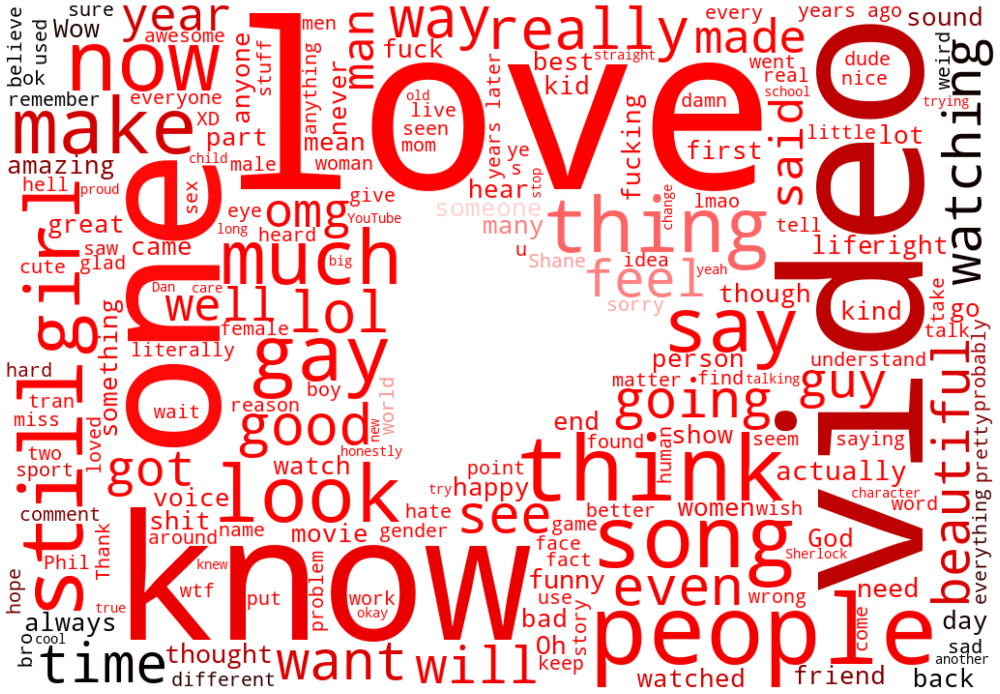

In [6]:
# Initialize Lemmatize

for x in identities:
    wordnet_lem = WordNetLemmatizer()

    temp_df = result_df[result_df["identity"] == x]
    # Lemmatize processed text and join everything in a list
    temp_df['text_lem'] = temp_df['processed_text'].apply(wordnet_lem.lemmatize)
    all_words_lem = ' '.join([word for word in temp_df['text_lem']])

    # Generate a word cloud image
    mask = np.array(Image.open("youtube.png"))
    stopwords = set(STOPWORDS)

    wordcloud_yt = WordCloud(height=708,
                                width=1024,
                                background_color="white",
                                mode="RGBA",
                                stopwords=stopwords,
                                mask=mask).generate(all_words_lem)

    # Create coloring from the image
    image_colors = ImageColorGenerator(mask)
    plt.figure(figsize=[20,20])
    plt.axis('off')
    plt.tight_layout(pad=0)
    plt.imshow(wordcloud_yt.recolor(color_func=image_colors), interpolation="bilinear")
    plt.savefig(f"wordcloud_{x}.png")